# FSI of a zero-mass 2d ellipse swimming in quiescent viscous flow

## <span style="color:blue"> Package and file name

In [1]:
using LaTeXStrings
using Revise
using BSON: @save, @load

using Pkg
Pkg.activate("../..")
using FSI

In [2]:
using Plots
pyplot()
clibrary(:colorbrewer)
default(grid = false)

┌ Warning: /home/fs/.julia/packages/Plots/cc8wh/src/Plots.jl/ is not an existing directory, Revise is not watching
└ @ Revise /home/fs/.julia/packages/Revise/agmgx/src/Revise.jl:422


In [3]:
filename = "2dSwim_ellipse_m=0";

## <span style="color:blue"> Set up rigid body with Dyn3d

#### Function for generating ellipse with grid points

In [4]:
"""
    ellipse(z₀, a, b, h)
Constuct a ellipse in y-direction

# Arguments
- 'z₀' : head point location
- 'a' : semi-major axis
- 'b' : semi-minor axis
- 'h' : point interval in the major axis direction
"""
function ellipse(z₀::Array{Float64,2}, a::Float64, b::Float64, h::Float64)
    # first half
    verts = [0.0 -a]
    re = 2a
    y = -a
    while re > h
        y += h
        verts = [verts; [b*sqrt(1-(y/a)^2) y]]
        re -= h
    end
    # mid point
    verts = [verts; [0 a]]
    re = 2a
    y = a
    # second half
    while re > h
        y -= h
        verts = verts = [verts; [-b*sqrt(1-(y/a)^2) y]]
        re -= h
    end    
    verts[:,1] .+= z₀[1]
    verts[:,2] .+= z₀[2] + a  
    return verts
end
;

#### Basic problem set up

In [5]:
# problem dimension
ndim = 2
# numerical params
tf = 4
dt = 1e-3
scheme = "Liska"
st = 5
tol = 1e-4
num_params = NumParams(tf, dt, scheme, st, tol)

# gravity
gravity = [0., 0., 0.]

# set up system config info
config_system = ConfigSystem(ndim, gravity, num_params)

# set up bodys
nbody = 3
ea = 0.5
eb = 0.05
verts = ellipse([0.0 0.0], ea, eb, 0.02)
nverts = size(verts,1)
config_body = ConfigBody(nbody, nverts, verts, 0.0)
config_bodys = fill(config_body, nbody)

# set up joints
njoint = nbody
config_joints = Vector{ConfigJoint}(undef,njoint)
gap = 0.1;

#### set the first passive planar joint with no stiff and damp

In [6]:
dof₁ = Vector{Dof}(undef,3)
[dof₁[i] = Dof(2*i, "passive", 0., 0., Motions()) for i = 1:3]
config_joints[1] = ConfigJoint(njoint, "custom_planar_in_y",
    [0.,0.,0.,0.6,0.,2.0], zeros(Float64,6), 0, dof₁, [0.0,0.0,0.0]);

#### set the second active joint with oscillatory motion

In [7]:
motion₂ = Motions("oscillatory", [-1.0, 1.0/(2*π), π/2])
dof₂ = Dof(2, "active", 0., 0., motion₂)
config_joints[2] = ConfigJoint(njoint, "custom_revolute_in_y",
   [0., 0., 0., 1.0+gap, 0., 0.],[0., 0., 0., -gap, 0., 0.],
   1, [dof₂], [0.]);

#### set the third active joint with oscillatory motion

In [8]:
motion₃ = Motions("oscillatory", [-1.0, 1.0/(2*π), -π])
dof₃ = Dof(2, "active", 0., 0., motion₃)
config_joints[3] = ConfigJoint(njoint, "custom_revolute_in_y",
   [0., 0., 0., 1.0+gap, 0., 0.],[0., 0., 0., -gap, 0., 0.],
   2, [dof₃], [0.]);

#### Build joint-body chain

In [9]:
bs, js, bsys = BuildChain(config_bodys, config_joints, config_system)
bd = BodyDyn(bs, js, bsys);

#### Initialize rigid body system state to complete body-joint information

In [10]:
bd, soln₀ = InitSystem!(bd;influid=true);

#### Initialize u and λ container

In [11]:
qJ = soln₀.qJ
v = soln₀.v
λ_dim = bd.sys.ncdof_HERK
λ = zeros(Float64,λ_dim);

#### Plot body only

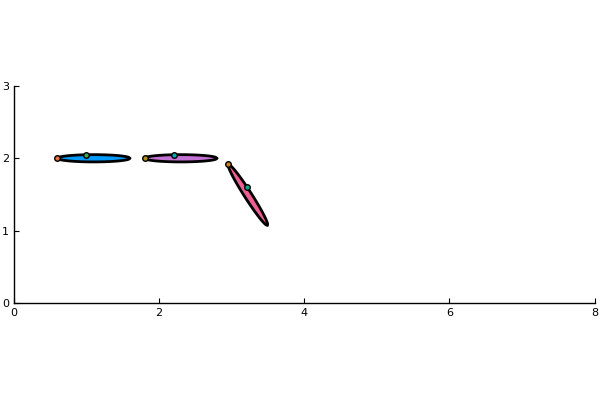

In [12]:
@get bd (bs, js, sys)
bs, js, sys = UpdatePosition!(bs, js, sys, soln₀.qJ)
vs₀ = VertsHistory(sys.nbody, bs);

p = plot()
for i = 1:sys.nbody
    plot!(p,vs₀[i,[1:nverts;1],1], vs₀[i,[1:nverts;1],3],linewidth=2,linecolor="black",fill=true)
    plot!(p,[vs₀[i,1,1]],[vs₀[i,1,3]],seriestype=:scatter)
    plot!(p,[vs₀[i,21,1]],[vs₀[i,21,3]],seriestype=:scatter)
end
plot!(xlims=(0,8), ylims=(0,3), ratio=1, legend=false)

## <span style="color:blue"> Set up fluid domain with ViscousFlow </span>

#### Set the flow parameters

In [15]:
Re = 200 # Reynolds number
U = 0.0 # Free stream velocity
U∞ = (0.0, U)

(0.0, 0.0)

#### Set the domain grid

In [16]:
nx = 402; ny = 152;
Ly = 3;
Δx = Ly/(ny-2);
Δt = min(0.5*Δx,0.5*Δx^2*Re)
w₀ = Nodes(Dual,(nx,ny))
xg, yg = coordinates(w₀,dx=Δx)

(-0.01:0.02:8.01, -0.01:0.02:3.0100000000000002)

#### Set up fluid initial conditions

In [17]:
w₀ .= 0.0;
w = deepcopy(w₀);

## <span style="color:blue"> Create fluid-body interface </span>

#### Body in fluid plane

In [18]:
plane = [1,3];

#### Genrate body grid points and get linear velocity on them

In [19]:
bgs = GenerateBodyGrid(bd; np=DetermineNP(nbody, Δx));

#### Get body points initial coordinates for fluids

In [20]:
bgs = AcquireBodyGridKinematics(bd,bgs);

#### Set up body grid points and force container in fluid

In [21]:
X̃ = BodyGridToVectorData(bgs,"coord";plane=plane)
f = VectorData(X̃);

#### Create fluidstruct structure

In [22]:
tf = 2500Δt
T = Δt:Δt:tf
fsys = FluidStruct((nx,ny),Re,Δx,Δt,U∞ = U∞, X̃ = X̃, rk=RK31)
N = length(X̃)÷2

300

## <span style="color:blue"> Create function object for time marching</span>

In [23]:
@time ifherk_coupled = IFHERK_coupled(fsys.Δt,bd,bgs,(w₀,qJ,v,f,λ),
                ((t,u) -> FSI.Systems.plan_intfact(t,u,fsys), FSI.B₁ᵀ, FSI.B₂),
                (M, G₁ᵀ, G₂, UpP, UpV),
                ((bd,bgs,f) -> T₁ᵀ(bd,bgs,f,fsys.Δx;plane=plane),
                 (bd,bgs,u) -> T₂(bd,bgs,u;plane=plane),
                 (bd,bgs) -> getX̃(bd,bgs;plane=plane)),
                ((w,t) -> FSI.r₁(w,t,fsys), bd -> F(bd,config_body.ρ), w -> U_inf(w,fsys), gti),
                fsys, tol=1e-3, rk=FSI.TimeMarching.RK31, bodydim=2, ρb=config_body.ρ)

 39.020708 seconds (171.00 M allocations: 10.086 GiB, 4.31% gc time)


Stage-3+ IF-HERK integrator with
   Time step size 0.01


In [24]:
fx = Float64[]
fy = Float64[]
t = 0.0
thist = []
whist = []
λhist = []
bdhist = BodyDyn[];

## <span style="color:blue"> Time Marching! </span>

In [ ]:
@time for ti in T
    
    @time global t, (w, f), (qJ, v, λ), bd = ifherk_coupled(t, w, qJ, v, bd,fsys)
    
    push!(thist,t-Δt)
    push!(fx,sum(f.u)*Δx^2)
    push!(fy,sum(f.v)*Δx^2)
    push!(λhist,deepcopy(λ))
    push!(whist,deepcopy(w))
    push!(bdhist,deepcopy(bd))
    println("next time unit is $(round(t,digits=3))")
    
end

## <span style="color:blue"> Plot </span>

#### Set contour levels and fps

In [26]:
contour_levels = range(-5*Δx,stop=5*Δx,length=40)
sample_rate = 5
clims = (-5*Δx,5*Δx)
fps = 25;

In [28]:
contour_levels

-0.1:0.005128205128205128:0.1

#### Get body verts history

In [29]:
# get verts info based on this regular grid solution
vshist = []
for i = 1:length(bdhist)
    @get bdhist[i] (bs, js, sys)
    push!(vshist, VertsHistory(sys.nbody, bs))
end
fb = [1:nverts;1];

#### Plot first and last time field

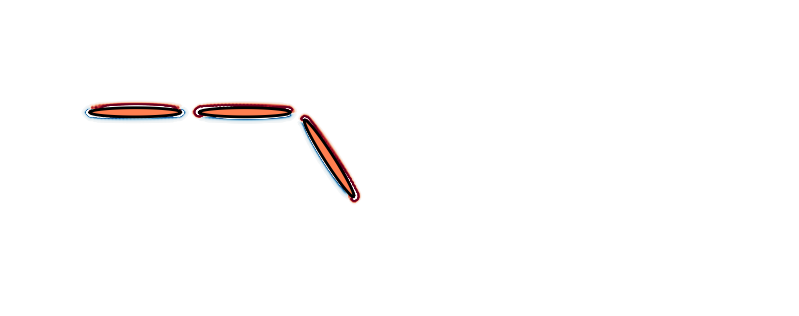

In [30]:
kk = 1
v1_x = []
v1_y = []
for j = 1:kk
    push!(v1_x,0.5*(vshist[j][2,1,1]+vshist[j][2,51,1]))
    push!(v1_y,0.5*(vshist[j][2,1,3]+vshist[j][2,51,3]))
end

p = plot(xg,yg,whist[kk],levels=contour_levels,color=:RdBu_r,clims=clims,size=(800,300),framestyle=:none)
for i = 1:bd.sys.nbody
    plot!(p,vshist[kk][i,fb,plane[1]], vshist[kk][i,fb,plane[2]],linewidth=2,linecolor="black", fill=true,fillcolor=:coral)
end
plot!(p,v1_x,v1_y,linecolor="red")
savefig(p,"plot_for_paper/ellipse_m=0_t=0.pdf")

#### 0.8T

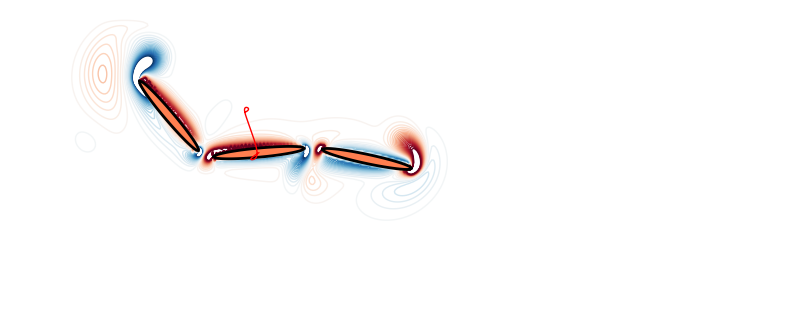

In [31]:
kk = 502
v1_x = []
v1_y = []
for j = 1:kk
    push!(v1_x,0.5*(vshist[j][2,1,1]+vshist[j][2,51,1]))
    push!(v1_y,0.5*(vshist[j][2,1,3]+vshist[j][2,51,3]))
end

p = plot(xg,yg,whist[kk],levels=contour_levels,color=:RdBu_r,clims=clims,size=(800,300),framestyle=:none)
for i = 1:bd.sys.nbody
    plot!(p,vshist[kk][i,fb,plane[1]], vshist[kk][i,fb,plane[2]],linewidth=2,linecolor="black", fill=true,fillcolor=:coral)
end
plot!(p,v1_x,v1_y,linecolor="red")
savefig(p,"plot_for_paper/ellipse_m=0_t=0.8T.pdf")

#### 1.6T

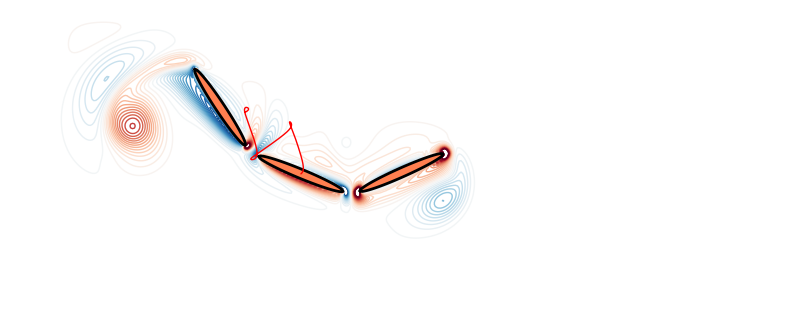

In [32]:
kk = 1005
v1_x = []
v1_y = []
for j = 1:kk
    push!(v1_x,0.5*(vshist[j][2,1,1]+vshist[j][2,51,1]))
    push!(v1_y,0.5*(vshist[j][2,1,3]+vshist[j][2,51,3]))  
end

p = plot(xg,yg,whist[kk],levels=contour_levels,color=:RdBu_r,clims=clims,size=(800,300),framestyle=:none)
for i = 1:bd.sys.nbody
    plot!(p,vshist[kk][i,fb,plane[1]], vshist[kk][i,fb,plane[2]],linewidth=2,linecolor="black", fill=true,fillcolor=:coral)
end
plot!(p,v1_x,v1_y,linecolor="red")
savefig(p,"plot_for_paper/ellipse_m=0_t=1.6T.pdf")

#### 2.39T

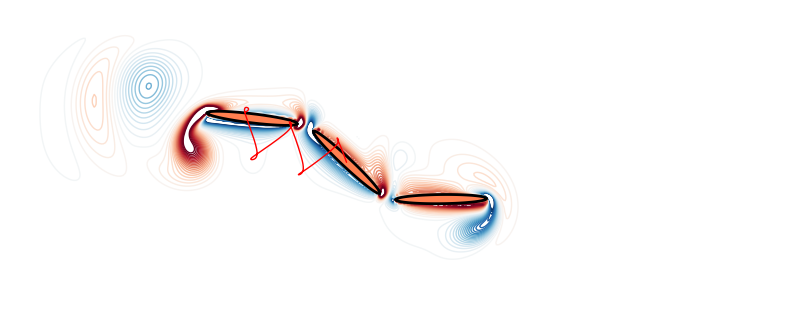

In [33]:
kk = 1501
v1_x = []
v1_y = []
for j = 1:kk
    push!(v1_x,0.5*(vshist[j][2,1,1]+vshist[j][2,51,1]))
    push!(v1_y,0.5*(vshist[j][2,1,3]+vshist[j][2,51,3])) 
end

p = plot(xg,yg,whist[kk],levels=contour_levels,color=:RdBu_r,clims=clims,size=(800,300),framestyle=:none)
for i = 1:bd.sys.nbody
    plot!(p,vshist[kk][i,fb,plane[1]], vshist[kk][i,fb,plane[2]],linewidth=2,linecolor="black", fill=true,fillcolor=:coral)
end
plot!(p,v1_x,v1_y,linecolor="red")
savefig(p,"plot_for_paper/ellipse_m=0_t=2.39T.pdf")

#### 3.18T

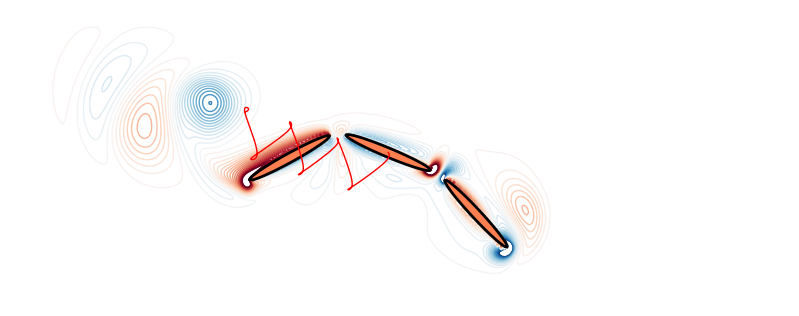

In [34]:
kk = 1998
v1_x = []
v1_y = []
for j = 1:kk
    push!(v1_x,0.5*(vshist[j][2,1,1]+vshist[j][2,51,1]))
    push!(v1_y,0.5*(vshist[j][2,1,3]+vshist[j][2,51,3]))
end

p = plot(xg,yg,whist[kk],levels=contour_levels,color=:RdBu_r,clims=clims,size=(800,300),framestyle=:none)
for i = 1:bd.sys.nbody
    plot!(p,vshist[kk][i,fb,plane[1]], vshist[kk][i,fb,plane[2]],linewidth=2,linecolor="black", fill=true,fillcolor=:coral)
end
plot!(p,v1_x,v1_y,linecolor="red")
savefig(p,"plot_for_paper/ellipse_m=0_t=3.18T.pdf")

#### 3.98T

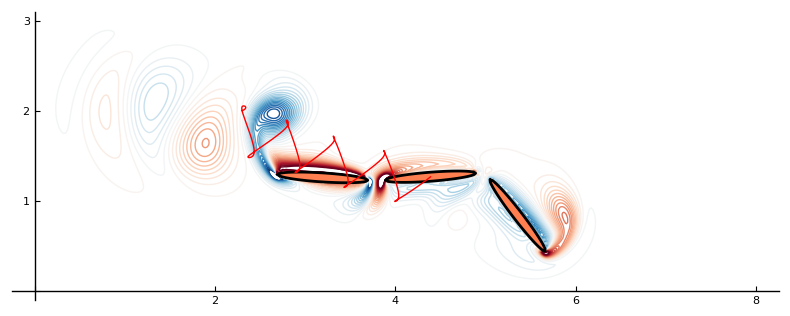

In [35]:
p = plot(xg,yg,whist[end],levels=contour_levels,color=:RdBu_r,clims=clims,size=(800,300),framestyle=:origin)
v1_x = []
v1_y = []
for j = 1:length(whist)
    push!(v1_x,0.5*(vshist[j][2,1,1]+vshist[j][2,51,1]))
    push!(v1_y,0.5*(vshist[j][2,1,3]+vshist[j][2,51,3])) 
end

for i = 1:bd.sys.nbody
    plot!(p,vshist[end][i,fb,plane[1]], vshist[end][i,fb,plane[2]],linewidth=2,linecolor="black", fill=true,fillcolor=:coral)
end
plot!(p,v1_x,v1_y,linecolor="red")
savefig(p,"plot_for_paper/ellipse_m=0_t=3.98T.pdf")

#### gif with tail

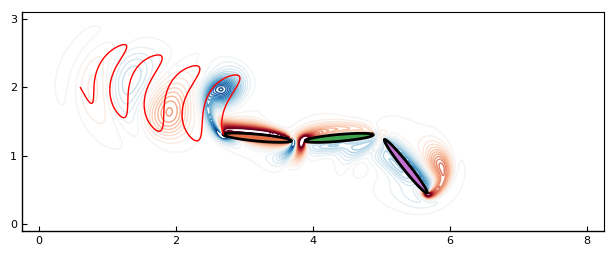

┌ Info: Saved animation to 
│   fn = /mnt/g/Research/FSI.jl/thesis/swimming fish/2dSwim_ellipse_m=0.gif
└ @ Plots /home/fs/.julia/packages/Plots/cc8wh/src/animation.jl:98


Plots.AnimatedGif("/mnt/g/Research/FSI.jl/thesis/swimming fish/2dSwim_ellipse_m=0.gif")
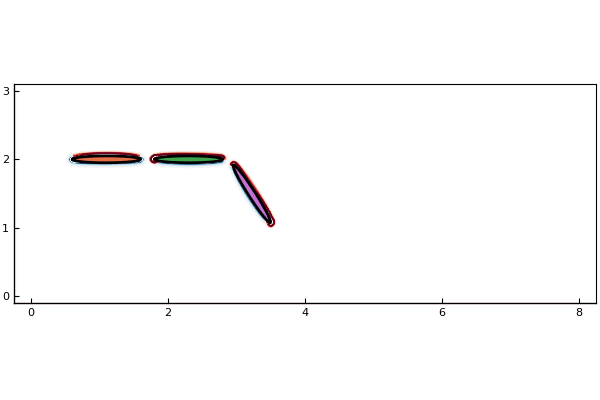

In [39]:
v1_x = []
v1_y = []

anim = @animate for j = 1:sample_rate:length(whist)
    plot(xg,yg,whist[j],levels=contour_levels,color=:RdBu_r,clims=clims)
    for i = 1:sys.nbody
        plot!(vshist[j][i,fb,plane[1]], vshist[j][i,fb,plane[2]],linewidth=2,linecolor="black", fill=true)
    end
    push!(v1_x,vshist[j][1,1,plane[1]])
    push!(v1_y,vshist[j][1,1,plane[2]])
    plot!(v1_x,v1_y,linecolor="red")
end

gif(anim, filename*".gif", fps = fps)

#### gif with 2nd body's center

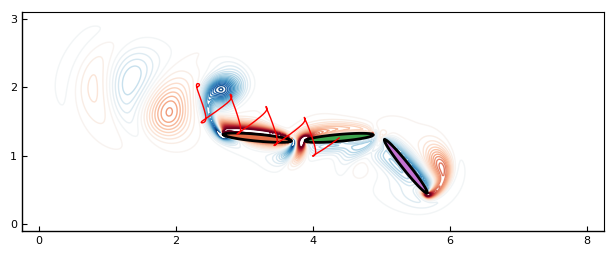

┌ Info: Saved animation to 
│   fn = /mnt/g/Research/FSI.jl/thesis/swimming fish/2dSwim_ellipse_m=0_center.gif
└ @ Plots /home/fs/.julia/packages/Plots/cc8wh/src/animation.jl:98


Plots.AnimatedGif("/mnt/g/Research/FSI.jl/thesis/swimming fish/2dSwim_ellipse_m=0_center.gif")
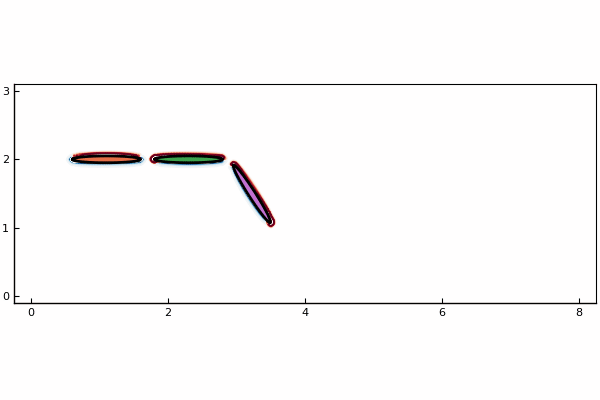

In [40]:
v1_x = []
v1_y = []

anim = @animate for j = 1:sample_rate:length(whist)
    plot(xg,yg,whist[j],levels=contour_levels,color=:RdBu_r,clims=clims)
    for i = 1:sys.nbody
        plot!(vshist[j][i,fb,plane[1]], vshist[j][i,fb,plane[2]],linewidth=2,linecolor="black", fill=true)
    end
    push!(v1_x,0.5*(vshist[j][2,1,1]+vshist[j][2,51,1]))
    push!(v1_y,0.5*(vshist[j][2,1,3]+vshist[j][2,51,3]))
    plot!(v1_x,v1_y,linecolor="red")
end

gif(anim, filename*"_center.gif", fps = fps)

#### position of the central body

In [42]:
using CSV

xdata = CSV.read("Eldredge2008JCP_data/2dSwim_X.csv",header=false)
tx = [xdata[i,1] for i in 1:length(xdata[1])]
xx = [xdata[i,2] for i in 1:length(xdata[2])];

ydata = CSV.read("Eldredge2008JCP_data/2dSwim_Y.csv",header=false)
ty = [ydata[i,1] for i in 1:length(ydata[1])]
yy = [ydata[i,2] for i in 1:length(ydata[2])];

αdata = CSV.read("Eldredge2008JCP_data/2dSwim_alpha.csv",header=false)
tα = [αdata[i,1] for i in 1:length(αdata[1])]
αα = [αdata[i,2] for i in 1:length(αdata[2])];

┌ Info: Recompiling stale cache file /home/fs/.julia/compiled/v1.0/CSV/HHBkp.ji for CSV [336ed68f-0bac-5ca0-87d4-7b16caf5d00b]
└ @ Base loading.jl:1190


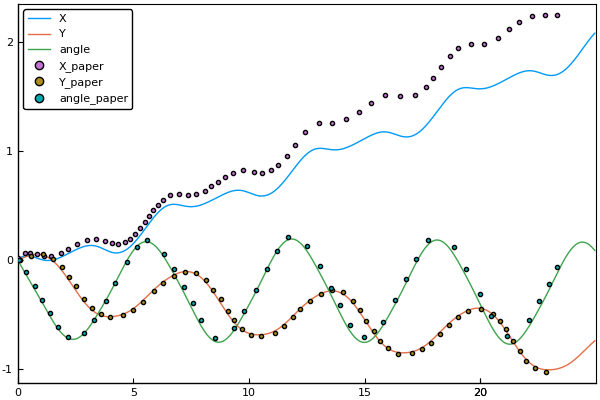

In [43]:
v2_x = []
v2_y = []
α2 = []
t_sampled = []
cnt = 1

for j = 1:sample_rate:length(whist)
    push!(t_sampled,thist[j])
    push!(v2_x,0.5*(vshist[j][2,1,1]+vshist[j][2,51,1])-2.3)
    push!(v2_y,0.5*(vshist[j][2,1,3]+vshist[j][2,51,3])-2)
    push!(α2,atan((v2_y[cnt]+2-vshist[j][2,1,3])/(v2_x[cnt]+2.3-vshist[j][2,1,1])))
    cnt += 1
end

plot(t_sampled,v2_x,label="X", framestyle = :box,xlim=(0,25))
plot!(t_sampled,v2_y,label="Y")
plot!(t_sampled,α2,label="angle")
scatter!(tx,xx,label="X_paper",markersize=3)
scatter!(ty,yy,label="Y_paper",markersize=3)
scatter!(tα,αα,label="angle_paper",markersize=3)

## <span style="color:blue"> Save and load data </span>

#### Save all current data related to plotting to a .bson file

In [48]:
@save filename*".bson" bd bdhist xg yg whist λhist vshist thist fx fy Δt w qJ v t f

#### Use the following block to extract data

In [49]:
# using Dyn3d
# using ViscousFlow

# @load filename*".bson" bd bdhist xg yg whist λhist vshist thist fx fy Δt w qJ v t f
# @get bd (bs,js,sys);

In [50]:
t

25.00000000000111